<a href="https://colab.research.google.com/github/Abhishek9895analyst/Appliances-Energy-Prediction/blob/main/Appliance_Energy_Prediction.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
# Importing the libraries
import numpy as np
import pandas as pd
from numpy import math

from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error

import matplotlib.pyplot as plt
import seaborn as sns

In [3]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [4]:
df = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/data/ data_application_energy.csv')

In [5]:
df.head()

,date,Appliances,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,RH_4,T5,RH_5,T6,RH_6,T7,RH_7,T8,RH_8,T9,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,rv1,rv2
0,2016-01-11 17:00:00,60,30,19.89,47.596667,19.2,44.790000,19.79,44.730000,19.000000,45.566667,17.166667,55.20,7.026667,84.256667,17.200000,41.626667,18.2,48.900000,17.033333,45.53,6.600000,733.5,92.0,7.000000,63.000000,5.3,13.275433,13.275433
1,2016-01-11 17:10:00,60,30,19.89,46.693333,19.2,44.722500,19.79,44.790000,19.000000,45.992500,17.166667,55.20,6.833333,84.063333,17.200000,41.560000,18.2,48.863333,17.066667,45.56,6.483333,733.6,92.0,6.666667,59.166667,5.2,18.606195,18.606195
2,2016-01-11 17:20:00,50,30,19.89,46.300000,19.2,44.626667,19.79,44.933333,18.926667,45.890000,17.166667,55.09,6.560000,83.156667,17.200000,41.433333,18.2,48.730000,17.000000,45.50,6.366667,733.7,92.0,6.333333,55.333333,5.1,28.642668,28.642668
3,2016-01-11 17:30:00,50,40,19.89,46.066667,19.2,44.590000,19.79,45.000000,18.890000,45.723333,17.166667,55.09,6.433333,83.423333,17.133333,41.290000,18.1,48.590000,17.000000,45.40,6.250000,733.8,92.0,6.000000,51.500000,5.0,45.410389,45.410389
4,2016-01-11 17:40:00,60,40,19.89,46.333333,19.2,44.530000,19.79,45.000000,18.890000,45.530000,17.200000,55.09,6.366667,84.893333,17.200000,41.230000,18.1,48.590000,17.000000,45.40,6.133333,733.9,92.0,5.666667,47.666667,4.9,10.084097,10.084097


In [6]:
len(df)

19735

In [7]:
  df.shape

(19735, 29)

In [8]:
df.dtypes

date            object
Appliances       int64
lights           int64
T1             float64
RH_1           float64
T2             float64
RH_2           float64
T3             float64
RH_3           float64
T4             float64
RH_4           float64
T5             float64
RH_5           float64
T6             float64
RH_6           float64
T7             float64
RH_7           float64
T8             float64
RH_8           float64
T9             float64
RH_9           float64
T_out          float64
Press_mm_hg    float64
RH_out         float64
Windspeed      float64
Visibility     float64
Tdewpoint      float64
rv1            float64
rv2            float64
dtype: object

In [9]:
df= df.drop('lights', axis=1)

In [10]:
df.shape

(19735, 28)

In [11]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19735 entries, 0 to 19734
Data columns (total 28 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   date         19735 non-null  object 
 1   Appliances   19735 non-null  int64  
 2   T1           19735 non-null  float64
 3   RH_1         19735 non-null  float64
 4   T2           19735 non-null  float64
 5   RH_2         19735 non-null  float64
 6   T3           19735 non-null  float64
 7   RH_3         19735 non-null  float64
 8   T4           19735 non-null  float64
 9   RH_4         19735 non-null  float64
 10  T5           19735 non-null  float64
 11  RH_5         19735 non-null  float64
 12  T6           19735 non-null  float64
 13  RH_6         19735 non-null  float64
 14  T7           19735 non-null  float64
 15  RH_7         19735 non-null  float64
 16  T8           19735 non-null  float64
 17  RH_8         19735 non-null  float64
 18  T9           19735 non-null  float64
 19  RH_9

In [12]:
df.describe()

,Appliances,T1,RH_1,T2,RH_2,T3,RH_3,T4,RH_4,T5,RH_5,T6,RH_6,T7,RH_7,T8,RH_8,T9,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,rv1,rv2
count,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000
mean,97.694958,21.686571,40.259739,20.341219,40.420420,22.267611,39.242500,20.855335,39.026904,19.592106,50.949283,7.910939,54.609083,20.267106,35.388200,22.029107,42.936165,19.485828,41.552401,7.411665,755.522602,79.750418,4.039752,38.330834,3.760707,24.988033,24.988033
std,102.524891,1.606066,3.979299,2.192974,4.069813,2.006111,3.254576,2.042884,4.341321,1.844623,9.022034,6.090347,31.149806,2.109993,5.114208,1.956162,5.224361,2.014712,4.151497,5.317409,7.399441,14.901088,2.451221,11.794719,4.194648,14.496634,14.496634
min,10.000000,16.790000,27.023333,16.100000,20.463333,17.200000,28.766667,15.100000,27.660000,15.330000,29.815000,-6.065000,1.000000,15.390000,23.200000,16.306667,29.600000,14.890000,29.166667,-5.000000,729.300000,24.000000,0.000000,1.000000,-6.600000,0.005322,0.005322
25%,50.000000,20.760000,37.333333,18.790000,37.900000,20.790000,36.900000,19.530000,35.530000,18.277500,45.400000,3.626667,30.025000,18.700000,31.500000,20.790000,39.066667,18.000000,38.500000,3.666667,750.933333,70.333333,2.000000,29.000000,0.900000,12.497889,12.497889
50%,60.000000,21.600000,39.656667,20.000000,40.500000,22.100000,38.530000,20.666667,38.400000,19.390000,49.090000,7.300000,55.290000,20.033333,34.863333,22.100000,42.375000,19.390000,40.900000,6.916667,756.100000,83.666667,3.666667,40.000000,3.433333,24.897653,24.897653
75%,100.000000,22.600000,43.066667,21.500000,43.260000,23.290000,41.760000,22.100000,42.156667,20.619643,53.663333,11.256000,83.226667,21.600000,39.000000,23.390000,46.536000,20.600000,44.338095,10.408333,760.933333,91.666667,5.500000,40.000000,6.566667,37.583769,37.583769
max,1080.000000,26.260000,63.360000,29.856667,56.026667,29.236000,50.163333,26.200000,51.090000,25.795000,96.321667,28.290000,99.900000,26.000000,51.400000,27.230000,58.780000,24.500000,53.326667,26.100000,772.300000,100.000000,14.000000,66.000000,15.500000,49.996530,49.996530


In [13]:
df.set_index('date')

,Appliances,T1,RH_1,T2,RH_2,T3,RH_3,T4,RH_4,T5,RH_5,T6,RH_6,T7,RH_7,T8,RH_8,T9,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,rv1,rv2
date,,,,,,,,,,,,,,,,,,,,,,,,,,,
2016-01-11 17:00:00,60,19.890000,47.596667,19.200000,44.790000,19.790000,44.730000,19.000000,45.566667,17.166667,55.200000,7.026667,84.256667,17.200000,41.626667,18.2000,48.900000,17.033333,45.5300,6.600000,733.5,92.000000,7.000000,63.000000,5.300000,13.275433,13.275433
2016-01-11 17:10:00,60,19.890000,46.693333,19.200000,44.722500,19.790000,44.790000,19.000000,45.992500,17.166667,55.200000,6.833333,84.063333,17.200000,41.560000,18.2000,48.863333,17.066667,45.5600,6.483333,733.6,92.000000,6.666667,59.166667,5.200000,18.606195,18.606195
2016-01-11 17:20:00,50,19.890000,46.300000,19.200000,44.626667,19.790000,44.933333,18.926667,45.890000,17.166667,55.090000,6.560000,83.156667,17.200000,41.433333,18.2000,48.730000,17.000000,45.5000,6.366667,733.7,92.000000,6.333333,55.333333,5.100000,28.642668,28.642668
2016-01-11 17:30:00,50,19.890000,46.066667,19.200000,44.590000,19.790000,45.000000,18.890000,45.723333,17.166667,55.090000,6.433333,83.423333,17.133333,41.290000,18.1000,48.590000,17.000000,45.4000,6.250000,733.8,92.000000,6.000000,51.500000,5.000000,45.410389,45.410389
2016-01-11 17:40:00,60,19.890000,46.333333,19.200000,44.530000,19.790000,45.000000,18.890000,45.530000,17.200000,55.090000,6.366667,84.893333,17.200000,41.230000,18.1000,48.590000,17.000000,45.4000,6.133333,733.9,92.000000,5.666667,47.666667,4.900000,10.084097,10.084097
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2016-05-27 17:20:00,100,25.566667,46.560000,25.890000,42.025714,27.200000,41.163333,24.700000,45.590000,23.200000,52.400000,24.796667,1.000000,24.500000,44.500000,24.7000,50.074000,23.200000,46.7900,22.733333,755.2,55.666667,3.333333,23.666667,13.333333,43.096812,43.096812
2016-05-27 17:30:00,90,25.500000,46.500000,25.754000,42.080000,27.133333,41.223333,24.700000,45.590000,23.230000,52.326667,24.196667,1.000000,24.557143,44.414286,24.7000,49.790000,23.200000,46.7900,22.600000,755.2,56.000000,3.500000,24.500000,13.300000,49.282940,49.282940
2016-05-27 17:40:00,270,25.500000,46.596667,25.628571,42.768571,27.050000,41.690000,24.700000,45.730000,23.230000,52.266667,23.626667,1.000000,24.540000,44.400000,24.7000,49.660000,23.200000,46.7900,22.466667,755.2,56.333333,3.666667,25.333333,13.266667,29.199117,29.199117


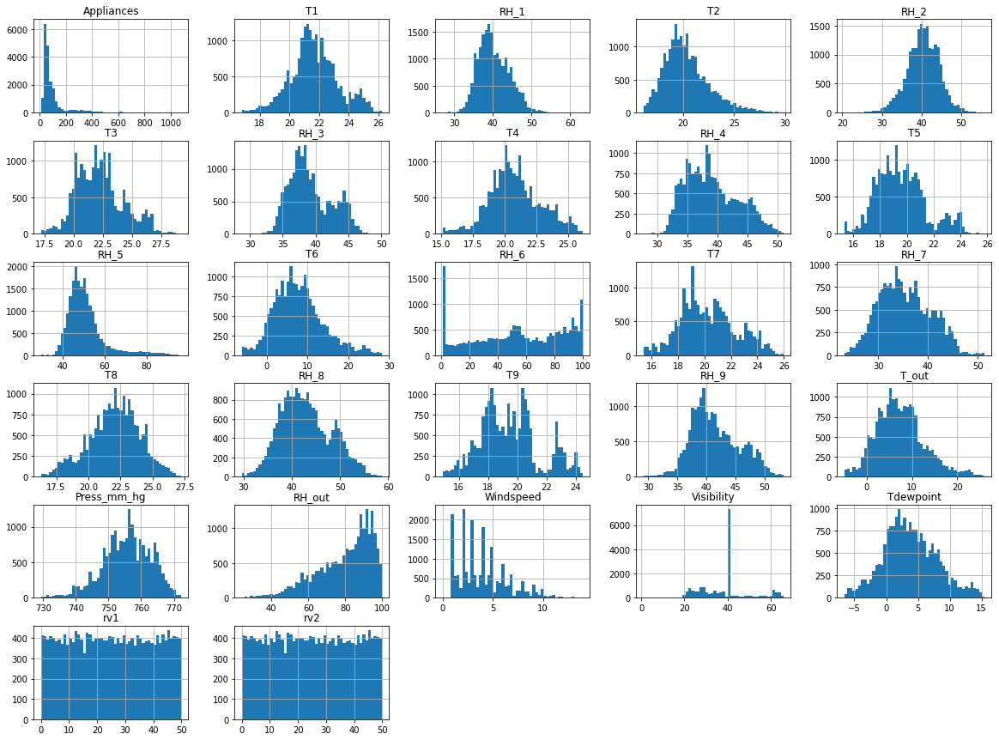

In [14]:
df.hist(bins=50, figsize=(20,15))
plt.show()

In [15]:
corr_df=df.corr()

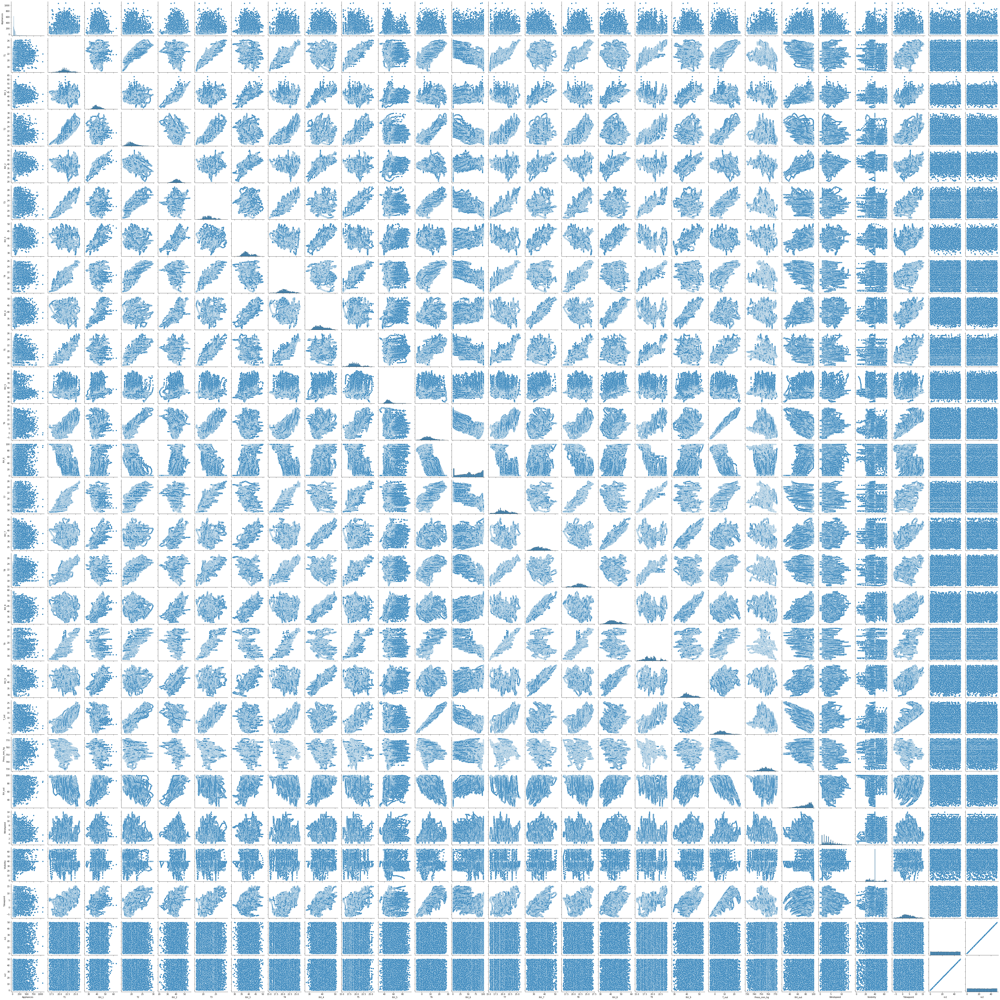

In [16]:
sns.pairplot(df)

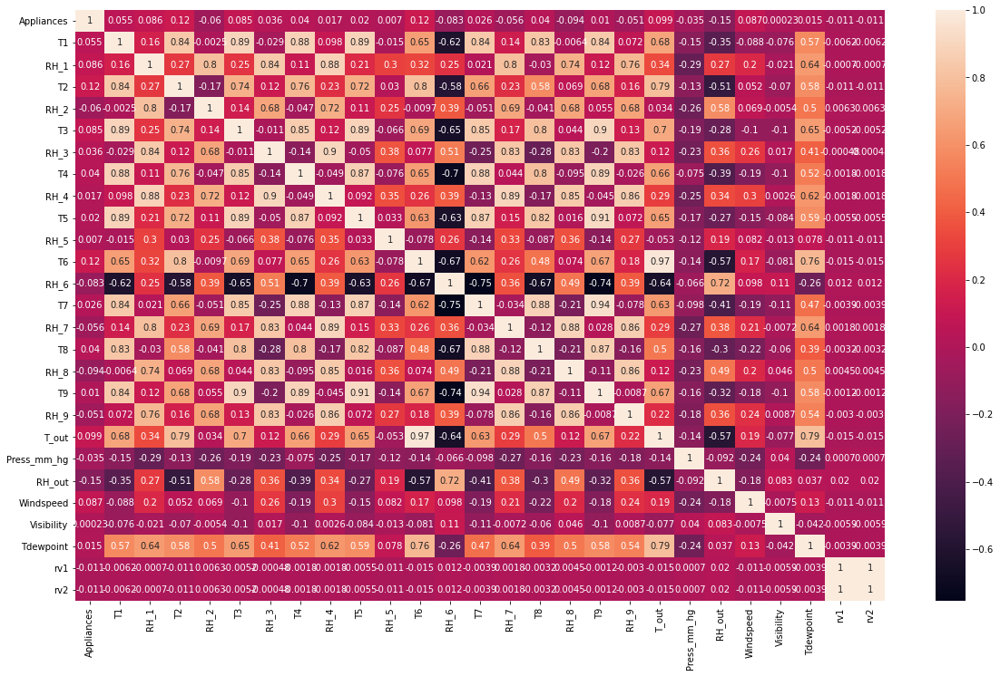

In [17]:
fig, ax = plt.subplots(figsize=(20,12))
sns.heatmap(corr_df, annot=True, ax=ax)

In [18]:
len(df[df.duplicated()])

0

In [31]:
sorted_appliances= df.sort_values('Appliances', ascending=False)
sorted_appliances.head()

,Appliances,T1,RH_1,T2,RH_2,T3,RH_3,T4,RH_4,T5,RH_5,T6,RH_6,T7,RH_7,T8,RH_8,T9,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,rv1,rv2
731,1080,21.930000,42.766667,21.040000,38.080000,20.700000,40.633333,20.89,39.733333,18.890000,51.881667,0.466667,96.090000,19.790,37.184286,20.926667,42.663333,17.79,40.672500,2.083333,765.033333,85.500000,3.666667,40.000000,-0.083333,27.408521,27.408521
1451,1070,19.600000,34.300000,18.426667,33.963333,18.390000,36.930000,17.70,35.400000,17.856667,37.608333,-1.600000,90.933333,17.290,28.225000,19.356667,37.429444,16.00,36.930000,-0.616667,764.533333,82.833333,1.000000,64.166667,-3.216667,11.735734,11.735734
432,910,21.463333,41.693333,20.856667,38.363333,21.666667,43.930000,18.70,42.660000,17.100000,53.000000,4.966667,74.166667,17.600,38.530000,18.200000,45.590000,17.00,43.466667,4.600000,747.900000,76.000000,7.000000,40.000000,0.700000,18.937972,18.937972
12088,900,23.000000,43.166667,22.200000,40.426667,26.100000,38.930000,21.60,41.526667,20.890000,45.833333,16.830000,12.730000,21.790,36.466667,24.666667,42.526667,20.70,43.333333,14.766667,749.266667,59.666667,7.000000,40.000000,7.000000,15.105153,15.105153
1452,890,19.730000,37.863333,18.566667,34.090000,18.390000,36.863333,17.60,35.133333,17.867778,37.728333,-1.730000,91.230000,17.235,28.153889,19.390000,37.228889,16.00,36.730000,-0.800000,764.500000,84.000000,1.000000,64.000000,-3.200000,3.221583,3.221583


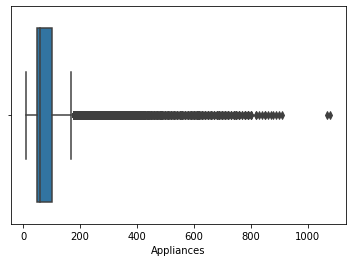

In [26]:
import seaborn as sns
sns.boxplot(x=df['Appliances'])

In [37]:
len(sorted_appliances)//1000

19

In [38]:
sorted_appliances.Appliances[:19]

731      1080
1451     1070
432       910
12088     900
1452      890
10668     880
14693     870
9031      860
19582     850
1821      850
15798     840
1307      830
19541     820
13821     820
867       800
1823      800
13786     800
12068     790
868       790
Name: Appliances, dtype: int64

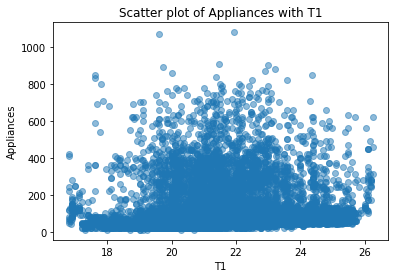

In [20]:
plt.scatter(df['T1'], df['Appliances'], alpha=0.5)
plt.title('Scatter plot of Appliances with T1')
plt.xlabel('T1')
plt.ylabel('Appliances')
plt.show()

In [21]:
dependent_variable = 'Appliances'
independent_variables = list(set(df.columns.tolist()) - {dependent_variable})

In [22]:
df[independent_variables]

,RH_1,T3,T9,Tdewpoint,rv2,T2,T7,rv1,T1,Press_mm_hg,date,T8,Visibility,RH_2,RH_6,RH_3,RH_4,RH_5,RH_8,RH_7,T5,T_out,T4,RH_9,T6,RH_out,Windspeed
0,47.596667,19.790000,17.033333,5.300000,13.275433,19.200000,17.200000,13.275433,19.890000,733.5,2016-01-11 17:00:00,18.2000,63.000000,44.790000,84.256667,44.730000,45.566667,55.200000,48.900000,41.626667,17.166667,6.600000,19.000000,45.5300,7.026667,92.000000,7.000000
1,46.693333,19.790000,17.066667,5.200000,18.606195,19.200000,17.200000,18.606195,19.890000,733.6,2016-01-11 17:10:00,18.2000,59.166667,44.722500,84.063333,44.790000,45.992500,55.200000,48.863333,41.560000,17.166667,6.483333,19.000000,45.5600,6.833333,92.000000,6.666667
2,46.300000,19.790000,17.000000,5.100000,28.642668,19.200000,17.200000,28.642668,19.890000,733.7,2016-01-11 17:20:00,18.2000,55.333333,44.626667,83.156667,44.933333,45.890000,55.090000,48.730000,41.433333,17.166667,6.366667,18.926667,45.5000,6.560000,92.000000,6.333333
3,46.066667,19.790000,17.000000,5.000000,45.410389,19.200000,17.133333,45.410389,19.890000,733.8,2016-01-11 17:30:00,18.1000,51.500000,44.590000,83.423333,45.000000,45.723333,55.090000,48.590000,41.290000,17.166667,6.250000,18.890000,45.4000,6.433333,92.000000,6.000000
4,46.333333,19.790000,17.000000,4.900000,10.084097,19.200000,17.200000,10.084097,19.890000,733.9,2016-01-11 17:40:00,18.1000,47.666667,44.530000,84.893333,45.000000,45.530000,55.090000,48.590000,41.230000,17.200000,6.133333,18.890000,45.4000,6.366667,92.000000,5.666667
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19730,46.560000,27.200000,23.200000,13.333333,43.096812,25.890000,24.500000,43.096812,25.566667,755.2,2016-05-27 17:20:00,24.7000,23.666667,42.025714,1.000000,41.163333,45.590000,52.400000,50.074000,44.500000,23.200000,22.733333,24.700000,46.7900,24.796667,55.666667,3.333333
19731,46.500000,27.133333,23.200000,13.300000,49.282940,25.754000,24.557143,49.282940,25.500000,755.2,2016-05-27 17:30:00,24.7000,24.500000,42.080000,1.000000,41.223333,45.590000,52.326667,49.790000,44.414286,23.230000,22.600000,24.700000,46.7900,24.196667,56.000000,3.500000
19732,46.596667,27.050000,23.200000,13.266667,29.199117,25.628571,24.540000,29.199117,25.500000,755.2,2016-05-27 17:40:00,24.7000,25.333333,42.768571,1.000000,41.690000,45.730000,52.266667,49.660000,44.400000,23.230000,22.466667,24.700000,46.7900,23.626667,56.333333,3.666667
19733,46.990000,26.890000,23.200000,13.233333,6.322784,25.414000,24.500000,6.322784,25.500000,755.2,2016-05-27 17:50:00,24.6625,26.166667,43.036000,1.000000,41.290000,45.790000,52.200000,49.518750,44.295714,23.200000,22.333333,24.700000,46.8175,22.433333,56.666667,3.833333
